# Analysis benchmark performance

## Load csv

In [49]:
import pandas as pd

# Load your CSV file (semicolon-delimited)
df = pd.read_csv("realbenchmark_partly.csv", sep=';')

# Quick sanity check
print(df.shape)
print(df.columns.tolist())
print(df.head())


(54, 45)
['timestamp', 'model', 'model_basename', 'target', 'num_nodes', 'num_inputs', 'num_edges', 'ndcg_ko', 'ndcg_ki', 'error_ko', 'error_ki', 'ave_cor_rows_all', 'ave_cor_rows_input', 'n_common_ko', 'n_common_ki', 'kendall_ko', 'kendall_ki', 'spearman_ko', 'spearman_ki', 'mean_abs_rank_diff_ko', 'mean_abs_rank_diff_ki', 'top10_jaccard_ko', 'top10_jaccard_ki', 'precision_at_10_ko', 'precision_at_10_ki', 'recall_at_10_ko', 'recall_at_10_ki', 'top20_jaccard_ko', 'top20_jaccard_ki', 'precision_at_20_ko', 'precision_at_20_ki', 'recall_at_20_ko', 'recall_at_20_ki', 'group_jaccard_1_ko', 'group_jaccard_1_ki', 'group_jaccard_2_ko', 'group_jaccard_2_ki', 'group_jaccard_3_ko', 'group_jaccard_3_ki', 'time_heading', 'time_simulate_original', 'time_original_analysis', 'time_propagation', 'returncode', 'log_file']
             timestamp                     model model_basename     target  \
0  2025-12-17T13:05:25  data/realbenchmark/1.txt              1  Apoptosis   
1  2025-12-17T13:05:31  data

In [23]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# NDCG for each model

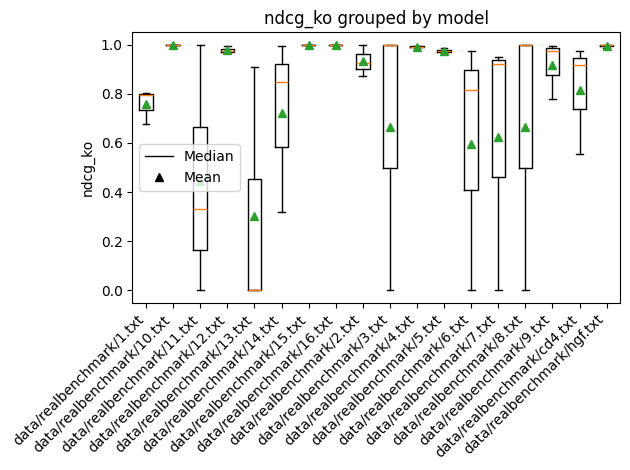

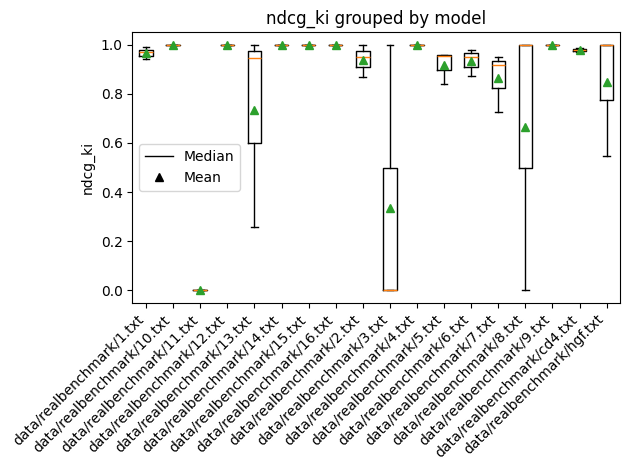

In [27]:
from matplotlib.lines import Line2D
labels = [m for m, _ in df.groupby("model")]

legend_elements = [
    Line2D([0], [0], color="black", lw=1, label="Median"),
    Line2D([0], [0], marker="^", color="black", linestyle="None", label="Mean"),
]

# ---- NDCG_KO ----
plt.figure()
data_ko = [g["ndcg_ko"].values for _, g in df.groupby("model")]

plt.boxplot(data_ko, labels=labels, showmeans=True)
plt.xticks(rotation=45, ha="right")
plt.ylabel("ndcg_ko")
plt.title("ndcg_ko grouped by model")
plt.legend(handles=legend_elements, loc="best")
plt.tight_layout()
plt.show()

# ---- NDCG_KI ----
plt.figure()
data_ki = [g["ndcg_ki"].values for _, g in df.groupby("model")]

plt.boxplot(data_ki, labels=labels, showmeans=True)
plt.xticks(rotation=45, ha="right")
plt.ylabel("ndcg_ki")
plt.title("ndcg_ki grouped by model")
plt.legend(handles=legend_elements, loc="best")
plt.tight_layout()
plt.show()

## NDCG vs Input size

### KO

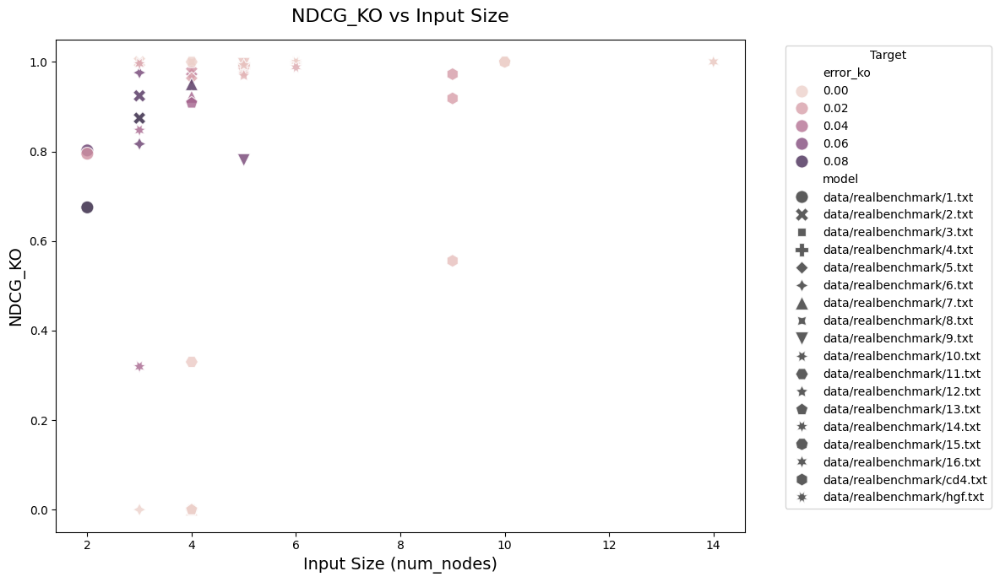

In [24]:
# Create a big, readable scatter plot
plt.figure(figsize=(12, 7))  # make it wide
sns.scatterplot(
    data=df,
    x="num_inputs",
    y="ndcg_ko",
    hue="error_ko",
    style="model",
    s=120,
    alpha=0.8
)

# Improve aesthetics
plt.title("NDCG_KO vs Input Size", fontsize=16, pad=15)
plt.xlabel("Input Size (num_nodes)", fontsize=14)
plt.ylabel("NDCG_KO", fontsize=14)
plt.legend(bbox_to_anchor=(1.05, 1), loc="upper left", title="Target", fontsize=10)
plt.tight_layout()
plt.show()

### KI

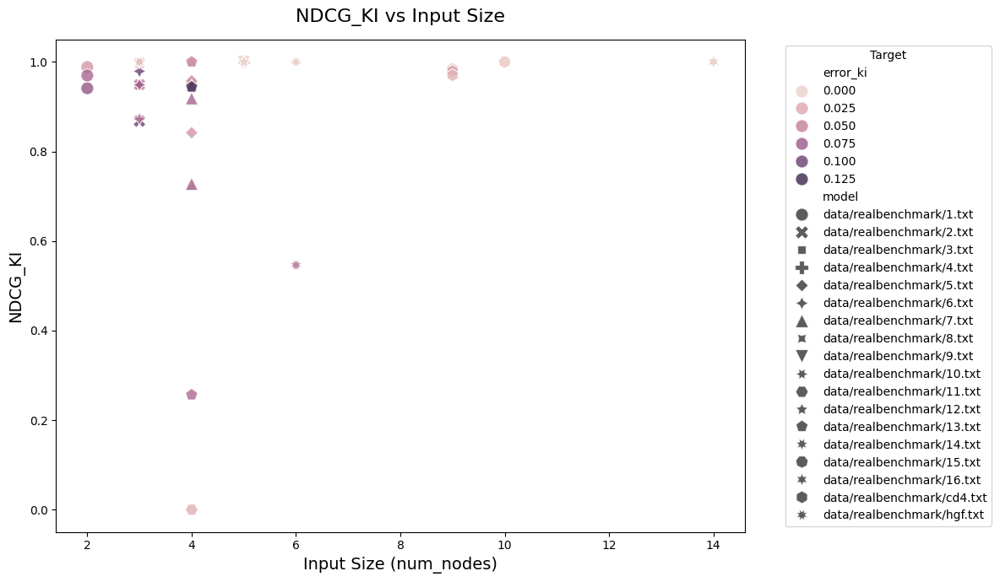

In [28]:
# Create a big, readable scatter plot
plt.figure(figsize=(12, 7))  # make it wide
sns.scatterplot(
    data=df,
    x="num_inputs",
    y="ndcg_ki",
    hue="error_ki",
    style="model",
    s=120,
    alpha=0.8
)

# Improve aesthetics
plt.title("NDCG_KI vs Input Size", fontsize=16, pad=15)
plt.xlabel("Input Size (num_nodes)", fontsize=14)
plt.ylabel("NDCG_KI", fontsize=14)
plt.legend(bbox_to_anchor=(1.05, 1), loc="upper left", title="Target", fontsize=10)
plt.tight_layout()
plt.show()

# NDCG vs Average Correct Rows for Inputs 

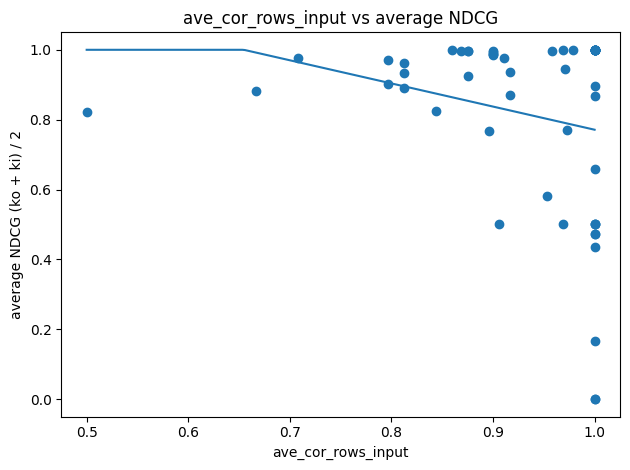

In [40]:
# Average NDCG
df["ndcg_avg"] = (df["ndcg_ko"] + df["ndcg_ki"]) / 2.0

x = df["ave_cor_rows_input"].values
y = df["ndcg_avg"].values

# Linear fit capped at 1.0
coef = np.polyfit(x, y, 1)
x_fit = np.linspace(x.min(), x.max(), 200)
y_fit = np.polyval(coef, x_fit)
y_fit = np.clip(y_fit, None, 1.0)

plt.figure()
plt.scatter(x, y)
plt.plot(x_fit, y_fit)
plt.xlabel("ave_cor_rows_input")
plt.ylabel("average NDCG (ko + ki) / 2")
plt.title("ave_cor_rows_input vs average NDCG")
plt.tight_layout()
plt.show()

# Time

/var/folders/01/v0p4sfw945j32p3yvg67p6cc0000gn/T/ipykernel_21259/1200257909.py:12: UserWarning: 

The `scale` parameter is deprecated and will be removed in v0.15.0. You can now control the size of each plot element using matplotlib `Line2D` parameters (e.g., `linewidth`, `markersize`, etc.).

  sns.pointplot(x='model', y='ratio', data=avg_ratio, color='red', markers='D', scale=1.2)


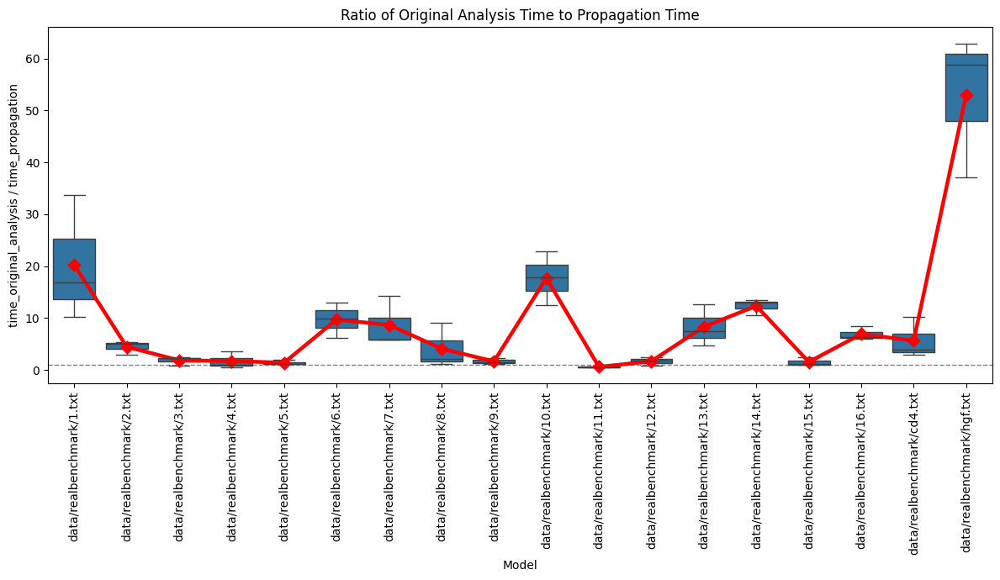

In [53]:
# Compute ratio
df['ratio'] = df['time_original_analysis'] / df['time_propagation']
# print(df['ratio'])

# Average over targets for each model
avg_ratio = df.groupby('model')['ratio'].mean().reset_index()

# Plot boxplot
plt.figure(figsize=(12,7))
plt.axhline(y=1, color='gray', linestyle='--', linewidth=1)
sns.boxplot(x='model', y='ratio', data=df)
sns.pointplot(x='model', y='ratio', data=avg_ratio, color='red', markers='D', scale=1.2)
plt.ylabel("time_original_analysis / time_propagation")
plt.xlabel("Model")
plt.title("Ratio of Original Analysis Time to Propagation Time")
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

# Perform analysis with different simulation probability for each model

In [1]:
from Shapley._core import testEachModel
from pathlib import Path
from benchmarker import parse_line

## Fast version

In [2]:
# load csv file 
txtpath = Path("realbenchmark_test.txt")
with txtpath.open("r", encoding="utf-8") as f:
    lines = f.readlines()

jobs = []
for ln in lines:
    # print(ln)
    parsed = parse_line(ln)
    if not parsed:
        continue
    model, targets = parsed
    for tgt in targets:
        jobs.append((model, tgt))
print(jobs)

[('data/realbenchmark/1.txt', 'Apoptosis'), ('data/realbenchmark/1.txt', 'Cas9'), ('data/realbenchmark/1.txt', 'Cas6'), ('data/realbenchmark/2.txt', 'SMO'), ('data/realbenchmark/2.txt', 'WG_p'), ('data/realbenchmark/2.txt', 'HH_p')]


In [3]:
stat_fast = dict()
for job in jobs:
    perlist = [0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50]
    onepair =  testEachModel(job[0], job[1], perlist)
    stat_fast[job] = onepair


List of all species:
{'PIP2', 'TNF', 'IAP', 'Cas3', 'AKT', 'TRADD', 'MEKK1', 'IkB', 'TRAF2', 'TNFR1', 'BAD', 'p53', 'PIP3', 'TRAF', 'DNADamageEvent', 'Apoptosis', 'JNKK', 'Cas7', 'TNFR2', 'PI3K', 'APC', 'PTEN', 'RIP', 'IKK', 'JNK', 'NFkB', 'BclX', 'A20', 'FADD', 'Cas8', 'BID', 'NIK', 'Cas6', 'Mito', 'Cas9', 'GFR', 'Mdm2', 'Cas12', 'cFLIP', 'GF', 'Apaf1'}
-----Input names-----
{'TNF', 'GF'}
----Intermediate nodes-----
{'PIP2', 'IAP', 'Cas3', 'AKT', 'TRADD', 'MEKK1', 'IkB', 'TRAF2', 'TNFR1', 'BAD', 'p53', 'PIP3', 'TRAF', 'DNADamageEvent', 'Apoptosis', 'JNKK', 'Cas7', 'TNFR2', 'PI3K', 'APC', 'PTEN', 'RIP', 'IKK', 'JNK', 'NFkB', 'BclX', 'A20', 'FADD', 'Cas8', 'BID', 'NIK', 'Cas6', 'Mito', 'Cas9', 'GFR', 'Mdm2', 'Cas12', 'cFLIP', 'Apaf1'}
Now arrange layout of the original network for visualization
Original network has 41 nodes and 73 edges
INPUT NAMES LIST:
['GF', 'TNF']
Sorted input names
['GF', 'TNF']
There are 2 inputs with the range of input: 0 3
Sorted internames:
['A20', 'AKT', 'APC'

In [4]:
print(stat_fast)

{('data/realbenchmark/1.txt', 'Apoptosis'): {'oritime': 4.501166105270386, 'propercentage': {0: {'protime': 0.25886168479919436, 'averightrows': 0.93125, 'averightinrows': 1.0, 'dncg': 0.89535}, 5: {'protime': 0.6786590099334717, 'averightrows': 0.9375, 'averightinrows': 1.0, 'dncg': 0.9030900000000001}, 10: {'protime': 0.9863505363464355, 'averightrows': 0.9362499999999999, 'averightinrows': 1.0, 'dncg': 0.9040800000000001}, 15: {'protime': 1.2008141994476318, 'averightrows': 0.9375, 'averightinrows': 1.0, 'dncg': 0.9215099999999999}, 20: {'protime': 1.4136547565460205, 'averightrows': 0.9387500000000001, 'averightinrows': 1.0, 'dncg': 0.9251400000000001}, 25: {'protime': 1.8651746273040772, 'averightrows': 0.9400000000000001, 'averightinrows': 1.0, 'dncg': 0.9198999999999999}, 30: {'protime': 2.2158380508422852, 'averightrows': 0.945, 'averightinrows': 1.0, 'dncg': 0.93026}, 35: {'protime': 2.5989031314849855, 'averightrows': 0.95, 'averightinrows': 1.0, 'dncg': 0.9444700000000001}, 

{0: {'oritime': 4.582455158233643, 'protime': 0.25819921493530273, 'rows': 0.93125, 'dncg': 0.89535}, 5: {'oritime': 4.479398012161255, 'protime': 0.6933057308197021, 'rows': 0.93125, 'dncg': 0.89535}, 10: {'oritime': 4.453901052474976, 'protime': 0.8115787506103516, 'rows': 0.93125, 'dncg': 0.89535}, 15: {'oritime': 4.4437620639801025, 'protime': 1.544957160949707, 'rows': 0.93125, 'dncg': 0.90655}, 20: {'oritime': 4.458705186843872, 'protime': 1.2656311988830566, 'rows': 0.91875, 'dncg': 0.90015}, 25: {'oritime': 4.430516958236694, 'protime': 2.188398599624634, 'rows': 0.94375, 'dncg': 0.8956}, 30: {'oritime': 4.469979286193848, 'protime': 2.191119909286499, 'rows': 0.93125, 'dncg': 0.89535}, 35: {'oritime': 4.472786903381348, 'protime': 2.6173455715179443, 'rows': 0.925, 'dncg': 0.9367}, 40: {'oritime': 4.4557859897613525, 'protime': 3.3060030937194824, 'rows': 0.94375, 'dncg': 0.9337}, 45: {'oritime': 4.555171966552734, 'protime': 3.2111737728118896, 'rows': 0.96875, 'dncg': 0.9635

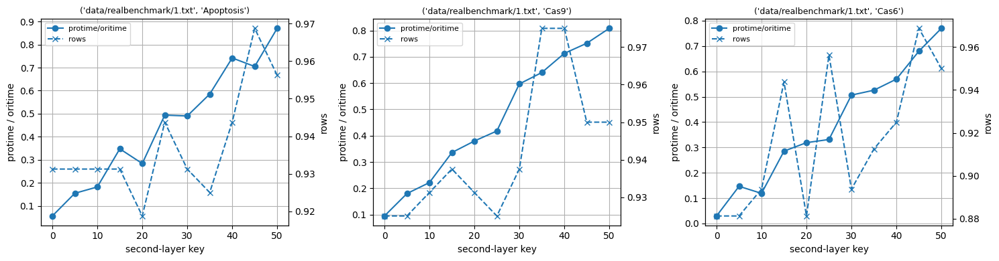

{0: {'oritime': 0.40199804306030273, 'protime': 0.0722050666809082, 'rows': 0.8203125, 'dncg': 0.871}, 5: {'oritime': 0.4092679023742676, 'protime': 0.1125040054321289, 'rows': 0.8515625, 'dncg': 0.8904}, 10: {'oritime': 0.40757226943969727, 'protime': 0.11223006248474121, 'rows': 0.8515625, 'dncg': 0.8904}, 15: {'oritime': 0.4128408432006836, 'protime': 0.13005590438842773, 'rows': 0.84375, 'dncg': 0.9014}, 20: {'oritime': 0.40723490715026855, 'protime': 0.15227198600769043, 'rows': 0.875, 'dncg': 0.9176}, 25: {'oritime': 0.4075000286102295, 'protime': 0.19905400276184082, 'rows': 0.8671875, 'dncg': 0.9073}, 30: {'oritime': 0.40087103843688965, 'protime': 0.20794391632080078, 'rows': 0.8984375, 'dncg': 0.9376}, 35: {'oritime': 0.4028310775756836, 'protime': 0.21776890754699707, 'rows': 0.875, 'dncg': 0.91525}, 40: {'oritime': 0.4049859046936035, 'protime': 0.2052600383758545, 'rows': 0.8984375, 'dncg': 0.9376}, 45: {'oritime': 0.403881311416626, 'protime': 0.28309106826782227, 'rows':

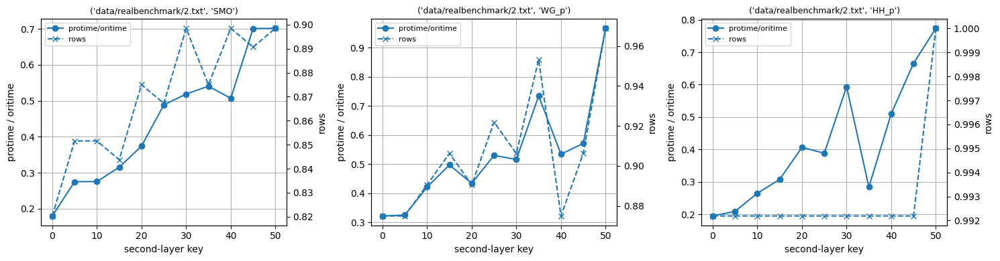

{0: {'oritime': 1.0151541233062744, 'protime': 1.0574431419372559, 'rows': 0.96875, 'dncg': 0.5}, 5: {'oritime': 0.9882838726043701, 'protime': 1.1785013675689697, 'rows': 0.96875, 'dncg': 0.5}, 10: {'oritime': 0.992056131362915, 'protime': 1.3447179794311523, 'rows': 0.96875, 'dncg': 0.5}, 15: {'oritime': 0.9888589382171631, 'protime': 1.1600620746612549, 'rows': 0.9791666666666666, 'dncg': 0.5}, 20: {'oritime': 0.9965579509735107, 'protime': 1.4879212379455566, 'rows': 0.96875, 'dncg': 0.5}, 25: {'oritime': 1.0071001052856445, 'protime': 1.4694459438323975, 'rows': 0.9791666666666666, 'dncg': 0.5}, 30: {'oritime': 0.9944088459014893, 'protime': 1.5441923141479492, 'rows': 0.96875, 'dncg': 0.5}, 35: {'oritime': 0.9965157508850098, 'protime': 1.6776340007781982, 'rows': 0.9791666666666666, 'dncg': 0.5}, 40: {'oritime': 0.9939961433410645, 'protime': 1.6434721946716309, 'rows': 0.96875, 'dncg': 0.5}, 45: {'oritime': 0.9960110187530518, 'protime': 1.9551033973693848, 'rows': 0.9791666666

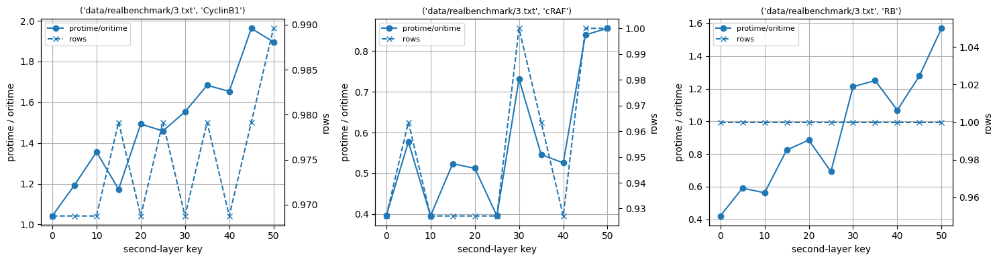

{0: {'oritime': 0.5918946266174316, 'protime': 0.9722931385040283, 'rows': 0.9958333333333333, 'dncg': 0.994}, 5: {'oritime': 0.5767509937286377, 'protime': 1.0594482421875, 'rows': 0.9958333333333333, 'dncg': 0.994}, 10: {'oritime': 0.5777561664581299, 'protime': 1.0704309940338135, 'rows': 1.0, 'dncg': 1.0}, 15: {'oritime': 0.5804579257965088, 'protime': 1.2297158241271973, 'rows': 0.9958333333333333, 'dncg': 0.994}, 20: {'oritime': 0.5889508724212646, 'protime': 1.2558002471923828, 'rows': 0.9958333333333333, 'dncg': 0.994}, 25: {'oritime': 0.6131489276885986, 'protime': 1.2577662467956543, 'rows': 0.9958333333333333, 'dncg': 0.994}, 30: {'oritime': 0.5850410461425781, 'protime': 1.066014051437378, 'rows': 0.9958333333333333, 'dncg': 0.994}, 35: {'oritime': 0.5790131092071533, 'protime': 1.4166429042816162, 'rows': 0.9958333333333333, 'dncg': 0.994}, 40: {'oritime': 0.5873680114746094, 'protime': 1.4522278308868408, 'rows': 1.0, 'dncg': 1.0}, 45: {'oritime': 0.5897741317749023, 'pro

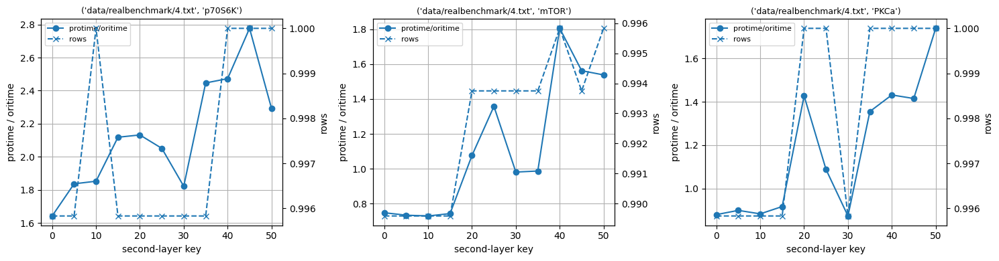

{0: {'oritime': 1.2950599193572998, 'protime': 1.1362378597259521, 'rows': 0.7302631578947368, 'dncg': 0.9634}, 5: {'oritime': 1.2989099025726318, 'protime': 1.139376163482666, 'rows': 0.7302631578947368, 'dncg': 0.9634}, 10: {'oritime': 1.3142280578613281, 'protime': 1.4628856182098389, 'rows': 0.8026315789473684, 'dncg': 0.9627}, 15: {'oritime': 1.286618947982788, 'protime': 1.8307080268859863, 'rows': 0.7401315789473684, 'dncg': 0.9633}, 20: {'oritime': 1.3132269382476807, 'protime': 1.6971259117126465, 'rows': 0.7664473684210527, 'dncg': 0.9768}, 25: {'oritime': 1.302189826965332, 'protime': 1.8539338111877441, 'rows': 0.7598684210526316, 'dncg': 0.9396}, 30: {'oritime': 1.3007421493530273, 'protime': 1.911224126815796, 'rows': 0.7796052631578947, 'dncg': 0.96565}, 35: {'oritime': 1.288201093673706, 'protime': 1.8498809337615967, 'rows': 0.8223684210526316, 'dncg': 0.9627}, 40: {'oritime': 1.2954959869384766, 'protime': 2.0916192531585693, 'rows': 0.8421052631578947, 'dncg': 0.9927

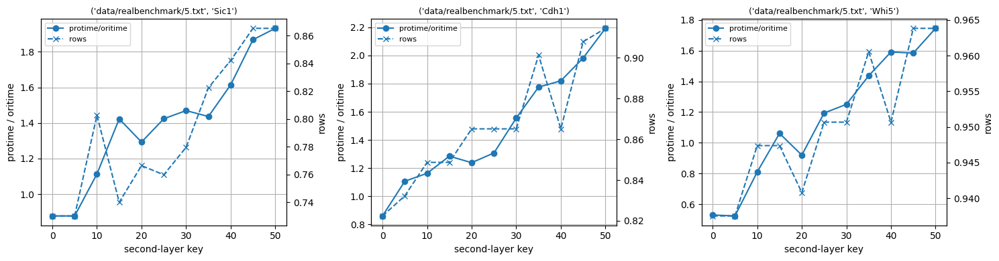

{0: {'oritime': 1.3344972133636475, 'protime': 0.13233351707458496, 'rows': 0.8148148148148149, 'dncg': 0.9776}, 5: {'oritime': 1.3327999114990234, 'protime': 0.21992707252502441, 'rows': 0.8148148148148149, 'dncg': 0.9776}, 10: {'oritime': 1.3471300601959229, 'protime': 0.29463768005371094, 'rows': 0.875, 'dncg': 0.99385}, 15: {'oritime': 1.3529329299926758, 'protime': 0.45902180671691895, 'rows': 0.837962962962963, 'dncg': 0.9796499999999999}, 20: {'oritime': 1.3468711376190186, 'protime': 0.6009764671325684, 'rows': 0.8425925925925926, 'dncg': 0.98245}, 25: {'oritime': 1.3546221256256104, 'protime': 0.5192887783050537, 'rows': 0.8703703703703703, 'dncg': 0.98685}, 30: {'oritime': 1.360929012298584, 'protime': 0.6703565120697021, 'rows': 0.9259259259259259, 'dncg': 0.9976}, 35: {'oritime': 1.3452732563018799, 'protime': 0.6456820964813232, 'rows': 0.8888888888888888, 'dncg': 0.98645}, 40: {'oritime': 1.347275972366333, 'protime': 0.6440770626068115, 'rows': 0.8842592592592593, 'dncg'

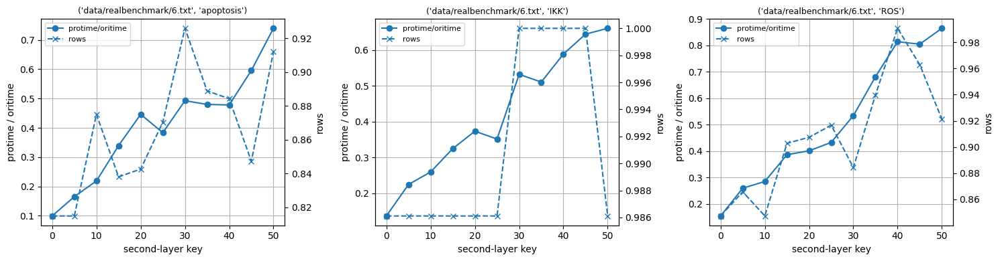

{0: {'oritime': 11.920764207839966, 'protime': 1.978848934173584, 'rows': 0.9011627906976745, 'dncg': 0.9341999999999999}, 5: {'oritime': 12.007179975509644, 'protime': 3.056337833404541, 'rows': 0.9273255813953488, 'dncg': 0.9502999999999999}, 10: {'oritime': 11.938519954681396, 'protime': 4.257984638214111, 'rows': 0.936046511627907, 'dncg': 0.9577}, 15: {'oritime': 12.018519878387451, 'protime': 4.263376235961914, 'rows': 0.9098837209302326, 'dncg': 0.9446}, 20: {'oritime': 11.99503207206726, 'protime': 5.561372518539429, 'rows': 0.9273255813953488, 'dncg': 0.9452}, 25: {'oritime': 12.008657932281494, 'protime': 6.717630863189697, 'rows': 0.9215116279069767, 'dncg': 0.9429}, 30: {'oritime': 12.043236017227173, 'protime': 7.610253095626831, 'rows': 0.938953488372093, 'dncg': 0.94985}, 35: {'oritime': 12.098317861557007, 'protime': 9.051859140396118, 'rows': 0.9505813953488372, 'dncg': 0.9538500000000001}, 40: {'oritime': 11.969158172607422, 'protime': 10.55644679069519, 'rows': 0.936

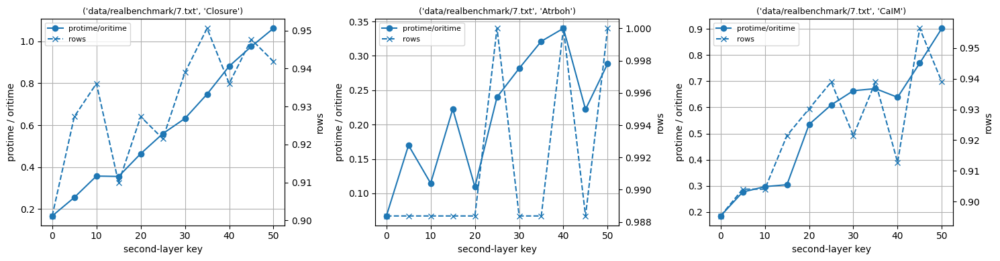

{0: {'oritime': 0.9502012729644775, 'protime': 0.33605194091796875, 'rows': 1.0, 'dncg': 1.0}, 5: {'oritime': 0.9445538520812988, 'protime': 0.47087621688842773, 'rows': 1.0, 'dncg': 1.0}, 10: {'oritime': 0.936830997467041, 'protime': 0.641411542892456, 'rows': 1.0, 'dncg': 1.0}, 15: {'oritime': 0.9287428855895996, 'protime': 0.7788610458374023, 'rows': 1.0, 'dncg': 1.0}, 20: {'oritime': 0.9429028034210205, 'protime': 0.7333922386169434, 'rows': 1.0, 'dncg': 1.0}, 25: {'oritime': 0.9163329601287842, 'protime': 1.097618818283081, 'rows': 1.0, 'dncg': 1.0}, 30: {'oritime': 0.9333770275115967, 'protime': 1.2973685264587402, 'rows': 1.0, 'dncg': 1.0}, 35: {'oritime': 0.9299912452697754, 'protime': 1.215735673904419, 'rows': 1.0, 'dncg': 1.0}, 40: {'oritime': 0.9201891422271729, 'protime': 1.212951898574829, 'rows': 1.0, 'dncg': 1.0}, 45: {'oritime': 0.9357860088348389, 'protime': 1.7240428924560547, 'rows': 1.0, 'dncg': 1.0}, 50: {'oritime': 0.9270467758178711, 'protime': 1.138446807861328

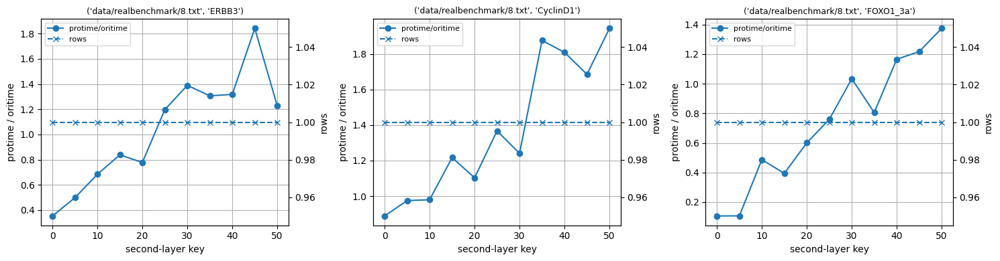

{0: {'oritime': 0.6446278095245361, 'protime': 0.2698218822479248, 'rows': 0.9583333333333334, 'dncg': 0.8903}, 5: {'oritime': 0.6569349765777588, 'protime': 0.28469181060791016, 'rows': 0.9583333333333334, 'dncg': 0.8903}, 10: {'oritime': 0.6433920860290527, 'protime': 0.2732830047607422, 'rows': 0.9583333333333334, 'dncg': 0.8903}, 15: {'oritime': 0.6615438461303711, 'protime': 0.4847524166107178, 'rows': 0.9583333333333334, 'dncg': 0.8903}, 20: {'oritime': 0.6426718235015869, 'protime': 0.633004903793335, 'rows': 0.9583333333333334, 'dncg': 0.8903}, 25: {'oritime': 0.6560649871826172, 'protime': 0.5094163417816162, 'rows': 0.9583333333333334, 'dncg': 0.8903}, 30: {'oritime': 0.6463391780853271, 'protime': 0.659351110458374, 'rows': 0.9583333333333334, 'dncg': 0.8903}, 35: {'oritime': 0.6555218696594238, 'protime': 0.9258339405059814, 'rows': 0.9583333333333334, 'dncg': 0.8903}, 40: {'oritime': 0.6552789211273193, 'protime': 1.1048712730407715, 'rows': 0.9625, 'dncg': 0.89005}, 45: {

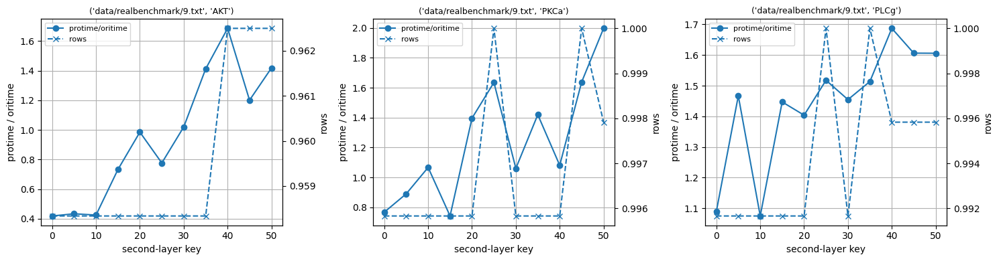

{0: {'oritime': 5.242236852645874, 'protime': 0.42174673080444336, 'rows': 1.0, 'dncg': 1.0}, 5: {'oritime': 5.224683046340942, 'protime': 0.4195394515991211, 'rows': 1.0, 'dncg': 1.0}, 10: {'oritime': 5.1918299198150635, 'protime': 0.420727014541626, 'rows': 1.0, 'dncg': 1.0}, 15: {'oritime': 5.261007785797119, 'protime': 0.4323546886444092, 'rows': 1.0, 'dncg': 1.0}, 20: {'oritime': 5.258646011352539, 'protime': 0.40761899948120117, 'rows': 1.0, 'dncg': 1.0}, 25: {'oritime': 5.2719950675964355, 'protime': 0.4199662208557129, 'rows': 1.0, 'dncg': 1.0}, 30: {'oritime': 5.289355039596558, 'protime': 0.42316269874572754, 'rows': 1.0, 'dncg': 1.0}, 35: {'oritime': 5.247390985488892, 'protime': 0.4136958122253418, 'rows': 1.0, 'dncg': 1.0}, 40: {'oritime': 5.257380723953247, 'protime': 0.4082760810852051, 'rows': 1.0, 'dncg': 1.0}, 45: {'oritime': 5.278224229812622, 'protime': 0.4213898181915283, 'rows': 1.0, 'dncg': 1.0}, 50: {'oritime': 5.2897069454193115, 'protime': 0.42421698570251465,

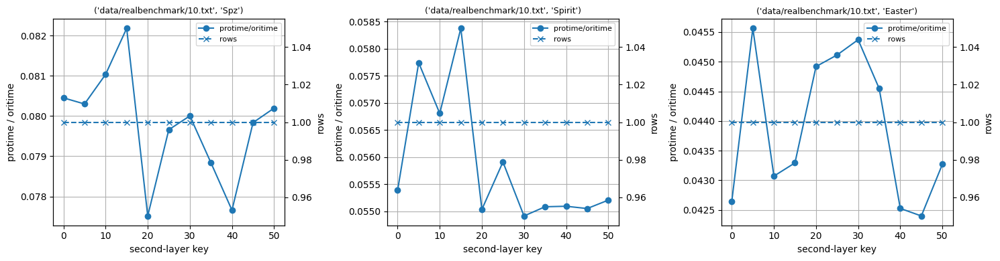

{0: {'oritime': 1.180799961090088, 'protime': 2.0370707511901855, 'rows': 0.9609375, 'dncg': 0.165}, 5: {'oritime': 1.1733500957489014, 'protime': 2.2344372272491455, 'rows': 0.9609375, 'dncg': 0.165}, 10: {'oritime': 1.1830909252166748, 'protime': 2.5120058059692383, 'rows': 0.9973958333333334, 'dncg': 0.165}, 15: {'oritime': 1.1835501194000244, 'protime': 2.2100980281829834, 'rows': 0.9609375, 'dncg': 0.165}, 20: {'oritime': 1.1857199668884277, 'protime': 2.1303930282592773, 'rows': 0.9609375, 'dncg': 0.165}, 25: {'oritime': 1.2116239070892334, 'protime': 2.778110980987549, 'rows': 0.9973958333333334, 'dncg': 0.165}, 30: {'oritime': 1.1826510429382324, 'protime': 2.675935983657837, 'rows': 0.9609375, 'dncg': 0.165}, 35: {'oritime': 1.1943869590759277, 'protime': 2.951608180999756, 'rows': 0.9635416666666666, 'dncg': 0.5}, 40: {'oritime': 1.1779530048370361, 'protime': 2.9772350788116455, 'rows': 0.9609375, 'dncg': 0.165}, 45: {'oritime': 1.1726560592651367, 'protime': 3.2347064018249

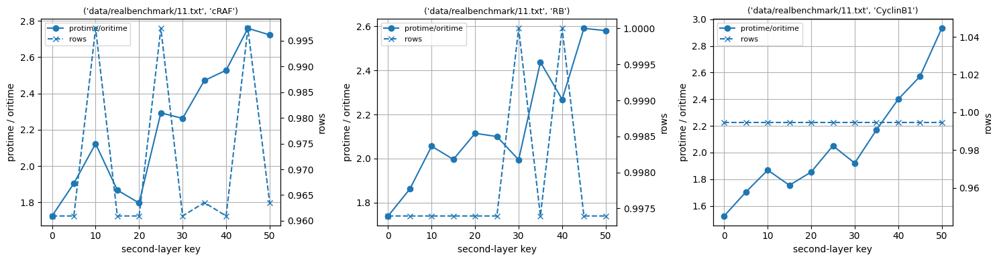

{0: {'oritime': 0.5164520740509033, 'protime': 0.5808537006378174, 'rows': 0.9916666666666667, 'dncg': 0.98695}, 5: {'oritime': 0.5134861469268799, 'protime': 0.5781800746917725, 'rows': 0.9916666666666667, 'dncg': 0.98695}, 10: {'oritime': 0.5222139358520508, 'protime': 0.5960278511047363, 'rows': 0.9916666666666667, 'dncg': 0.98695}, 15: {'oritime': 0.5038840770721436, 'protime': 0.7640016078948975, 'rows': 0.9916666666666667, 'dncg': 0.98695}, 20: {'oritime': 0.5192139148712158, 'protime': 0.7987613677978516, 'rows': 0.9958333333333333, 'dncg': 0.9941}, 25: {'oritime': 0.5034680366516113, 'protime': 0.8314769268035889, 'rows': 0.9958333333333333, 'dncg': 0.9941}, 30: {'oritime': 0.5147483348846436, 'protime': 0.7299730777740479, 'rows': 0.9958333333333333, 'dncg': 0.9941}, 35: {'oritime': 0.5299692153930664, 'protime': 0.7961888313293457, 'rows': 0.9958333333333333, 'dncg': 0.9941}, 40: {'oritime': 0.5171487331390381, 'protime': 0.8802676200866699, 'rows': 0.9916666666666667, 'dncg'

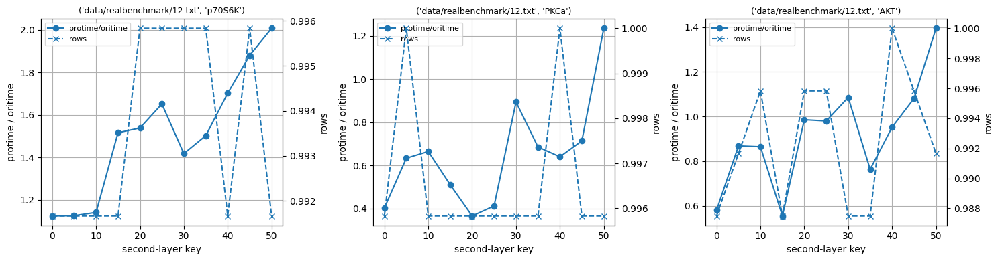

{0: {'oritime': 1.545346975326538, 'protime': 0.20225286483764648, 'rows': 0.9204545454545454, 'dncg': 0.5804}, 5: {'oritime': 1.5551152229309082, 'protime': 0.3567311763763428, 'rows': 0.9232954545454546, 'dncg': 0.5825}, 10: {'oritime': 1.5442471504211426, 'protime': 0.4372670650482178, 'rows': 0.9232954545454546, 'dncg': 0.8348}, 15: {'oritime': 1.5407819747924805, 'protime': 0.6311721801757812, 'rows': 0.9261363636363636, 'dncg': 0.5849}, 20: {'oritime': 1.5284321308135986, 'protime': 0.6485261917114258, 'rows': 0.9204545454545454, 'dncg': 0.8348}, 25: {'oritime': 1.5412869453430176, 'protime': 0.825775146484375, 'rows': 0.9403409090909091, 'dncg': 0.60865}, 30: {'oritime': 1.5372340679168701, 'protime': 1.0066096782684326, 'rows': 0.9375, 'dncg': 0.6006}, 35: {'oritime': 1.5495193004608154, 'protime': 1.1473374366760254, 'rows': 0.9375, 'dncg': 0.8348}, 40: {'oritime': 1.5502748489379883, 'protime': 1.0515270233154297, 'rows': 0.9403409090909091, 'dncg': 0.8348}, 45: {'oritime': 1

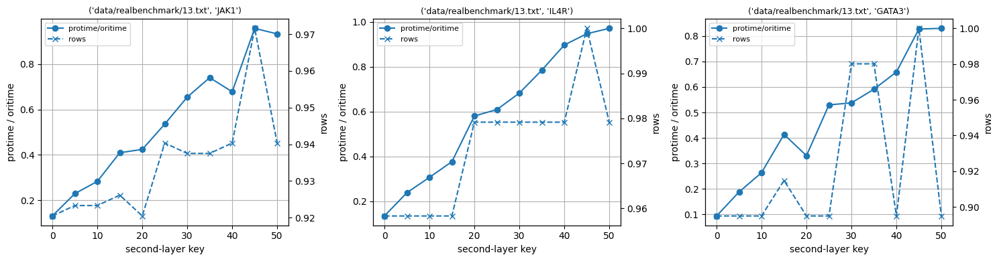

{0: {'oritime': 3.233006000518799, 'protime': 0.24959182739257812, 'rows': 0.9775641025641025, 'dncg': 0.6597999999999999}, 5: {'oritime': 3.2402753829956055, 'protime': 0.2521648406982422, 'rows': 0.9775641025641025, 'dncg': 0.6597999999999999}, 10: {'oritime': 3.2250559329986572, 'protime': 0.44138550758361816, 'rows': 0.9775641025641025, 'dncg': 0.6597999999999999}, 15: {'oritime': 3.264549732208252, 'protime': 0.4449315071105957, 'rows': 0.9775641025641025, 'dncg': 0.6597999999999999}, 20: {'oritime': 3.235991954803467, 'protime': 0.4452638626098633, 'rows': 0.9775641025641025, 'dncg': 0.6597999999999999}, 25: {'oritime': 3.2764129638671875, 'protime': 0.6563827991485596, 'rows': 0.983974358974359, 'dncg': 0.82685}, 30: {'oritime': 3.2479500770568848, 'protime': 0.7031757831573486, 'rows': 0.9807692307692307, 'dncg': 0.7925}, 35: {'oritime': 3.231001138687134, 'protime': 0.8899528980255127, 'rows': 0.983974358974359, 'dncg': 0.8926499999999999}, 40: {'oritime': 3.296220302581787, '

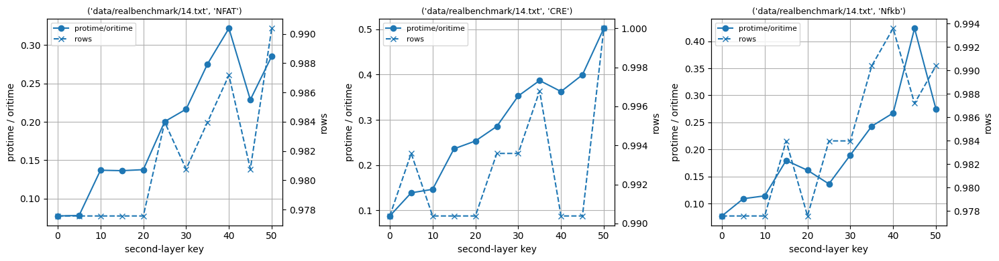

{0: {'oritime': 25.847711086273193, 'protime': 22.949897050857544, 'rows': 1.0, 'dncg': 1.0}, 5: {'oritime': 26.12832283973694, 'protime': 23.02920389175415, 'rows': 1.0, 'dncg': 1.0}, 10: {'oritime': 25.838727951049805, 'protime': 23.00544285774231, 'rows': 1.0, 'dncg': 1.0}, 15: {'oritime': 26.340779066085815, 'protime': 22.968031644821167, 'rows': 1.0, 'dncg': 1.0}, 20: {'oritime': 26.002846002578735, 'protime': 22.81572389602661, 'rows': 1.0, 'dncg': 1.0}, 25: {'oritime': 25.692907094955444, 'protime': 22.770126819610596, 'rows': 1.0, 'dncg': 1.0}, 30: {'oritime': 25.86143469810486, 'protime': 23.033463716506958, 'rows': 1.0, 'dncg': 1.0}, 35: {'oritime': 26.228394985198975, 'protime': 22.927359342575073, 'rows': 1.0, 'dncg': 1.0}, 40: {'oritime': 26.054058074951172, 'protime': 22.97340965270996, 'rows': 1.0, 'dncg': 1.0}, 45: {'oritime': 26.025364875793457, 'protime': 22.807390928268433, 'rows': 1.0, 'dncg': 1.0}, 50: {'oritime': 26.43270206451416, 'protime': 23.58492422103882, 'r

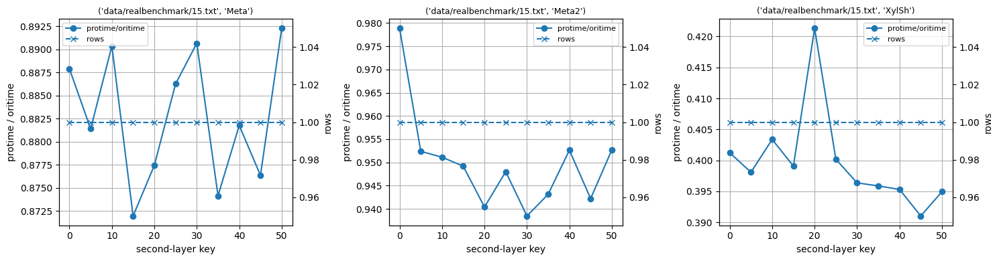

{0: {'oritime': 133.9851541519165, 'protime': 33.64361000061035, 'rows': 0.973606418918919, 'dncg': 0.77015}, 5: {'oritime': 133.24204897880554, 'protime': 59.0147008895874, 'rows': 0.9769847972972973, 'dncg': 0.7735000000000001}, 10: {'oritime': 132.21881914138794, 'protime': 54.43301486968994, 'rows': 0.9774070945945946, 'dncg': 0.8216}, 15: {'oritime': 134.11817002296448, 'protime': 95.33158588409424, 'rows': 0.9786739864864865, 'dncg': 0.82135}, 20: {'oritime': 135.58635067939758, 'protime': 94.35663962364197, 'rows': 0.9787795608108109, 'dncg': 0.77655}, 25: {'oritime': 132.97552013397217, 'protime': 103.46535444259644, 'rows': 0.9794130067567568, 'dncg': 0.77325}, 30: {'oritime': 132.37736821174622, 'protime': 116.98104047775269, 'rows': 0.9816300675675675, 'dncg': 0.82075}, 35: {'oritime': 133.11591482162476, 'protime': 147.78848004341125, 'rows': 0.985325168918919, 'dncg': 0.782}, 40: {'oritime': 133.80914783477783, 'protime': 115.93385672569275, 'rows': 0.9863809121621622, 'dn

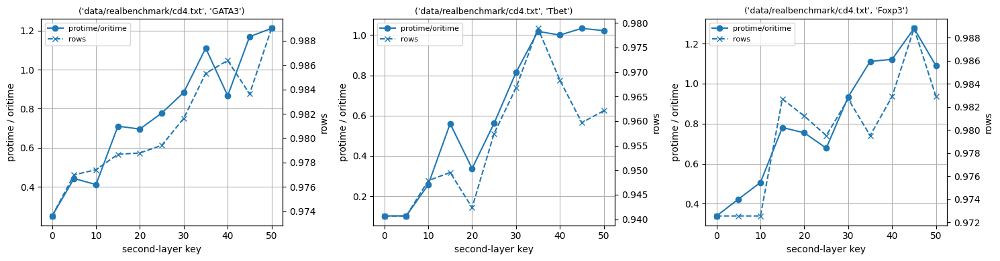

{0: {'oritime': 82.21940302848816, 'protime': 1.8351938724517822, 'rows': 0.9972014925373134, 'dncg': 0.9996499999999999}, 5: {'oritime': 82.91798400878906, 'protime': 8.060659408569336, 'rows': 0.9972014925373134, 'dncg': 0.9996499999999999}, 10: {'oritime': 81.44948887825012, 'protime': 6.47357177734375, 'rows': 0.9972014925373134, 'dncg': 0.9996499999999999}, 15: {'oritime': 82.05836319923401, 'protime': 9.769032001495361, 'rows': 0.9990671641791045, 'dncg': 0.9996499999999999}, 20: {'oritime': 83.84829688072205, 'protime': 13.867408990859985, 'rows': 0.9990671641791045, 'dncg': 0.9996499999999999}, 25: {'oritime': 81.5281229019165, 'protime': 21.86002278327942, 'rows': 0.9990671641791045, 'dncg': 0.9996499999999999}, 30: {'oritime': 82.65796089172363, 'protime': 19.537792444229126, 'rows': 0.9981343283582089, 'dncg': 1.0}, 35: {'oritime': 82.22713112831116, 'protime': 25.62676215171814, 'rows': 0.9972014925373134, 'dncg': 0.9996499999999999}, 40: {'oritime': 81.70568227767944, 'pro

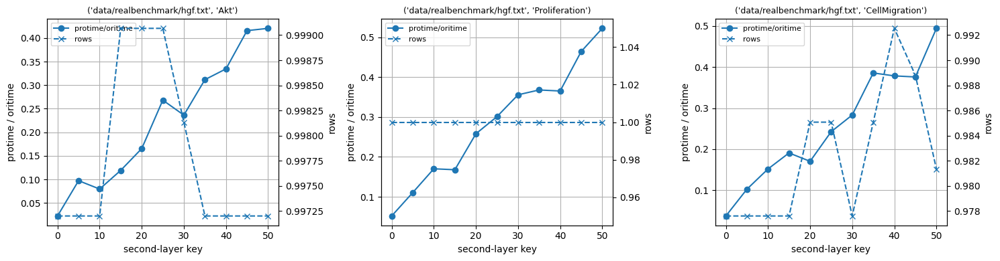

In [ ]:
import json
import matplotlib.pyplot as plt


keys = list(stat_fast.keys())

for i in range(0, len(keys), 3):
    group = keys[i:i+3]

    fig, axes = plt.subplots(1, len(group), figsize=(15, 4))

    if len(group) == 1:
        axes = [axes]

    for ax, k in zip(axes, group):
        item = stat_fast[k]
        print(item)
        x_vals = item.keys()
        print(x_vals)
        print(item[0]["protime"], item[0]["oritime"])
        ratio = [
            item[x]["protime"] / item[x]["oritime"]
            for x in x_vals
        ]
        rows = [item[x]["rows"] for x in x_vals]

        # left y-axis: ratio
        l1, = ax.plot(x_vals, ratio, marker="o", label="protime/oritime")
        ax.set_ylabel("protime / oritime")
        ax.set_xlabel("second-layer key")
        ax.grid(True)

        # right y-axis: rows
        ax2 = ax.twinx()
        l2, = ax2.plot(
            x_vals, rows, marker="x", linestyle="--", label="rows"
        )
        ax2.set_ylabel("rows")

        # combined legend
        ax.legend([l1, l2], ["protime/oritime", "rows"], fontsize=8)

        ax.set_title(str(k), fontsize=9)

    plt.tight_layout()
    plt.show()


## Full version

In [5]:
# load csv file 
txtpath = Path("realbenchmark.txt")
with txtpath.open("r", encoding="utf-8") as f:
    lines = f.readlines()

jobs = []
for ln in lines:
    # print(ln)
    parsed = parse_line(ln)
    if not parsed:
        continue
    model, targets = parsed
    for tgt in targets:
        jobs.append((model, tgt))
print(jobs)

[('data/realbenchmark/1.txt', 'Apoptosis'), ('data/realbenchmark/1.txt', 'Cas9'), ('data/realbenchmark/1.txt', 'Cas6'), ('data/realbenchmark/2.txt', 'SMO'), ('data/realbenchmark/2.txt', 'WG_p'), ('data/realbenchmark/2.txt', 'HH_p'), ('data/realbenchmark/3.txt', 'CyclinB1'), ('data/realbenchmark/3.txt', 'cRAF'), ('data/realbenchmark/3.txt', 'RB'), ('data/realbenchmark/4.txt', 'p70S6K'), ('data/realbenchmark/4.txt', 'mTOR'), ('data/realbenchmark/4.txt', 'PKCa'), ('data/realbenchmark/5.txt', 'Sic1'), ('data/realbenchmark/5.txt', 'Cdh1'), ('data/realbenchmark/5.txt', 'Whi5'), ('data/realbenchmark/6.txt', 'apoptosis'), ('data/realbenchmark/6.txt', 'IKK'), ('data/realbenchmark/6.txt', 'ROS'), ('data/realbenchmark/7.txt', 'Closure'), ('data/realbenchmark/7.txt', 'Atrboh'), ('data/realbenchmark/7.txt', 'CaIM'), ('data/realbenchmark/8.txt', 'ERBB3'), ('data/realbenchmark/8.txt', 'CyclinD1'), ('data/realbenchmark/8.txt', 'FOXO1_3a'), ('data/realbenchmark/9.txt', 'AKT'), ('data/realbenchmark/9.tx

In [6]:
stat = dict()
for job in jobs:
    perlist = [0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50]
    onepair =  testEachModel(job[0], job[1], perlist)
    stat[job] = onepair

List of all species:
{'A20', 'PTEN', 'Cas7', 'BclX', 'NIK', 'Mito', 'Cas8', 'GFR', 'Apoptosis', 'p53', 'FADD', 'GF', 'Cas3', 'PIP2', 'APC', 'Mdm2', 'BID', 'TRAF', 'BAD', 'TNFR1', 'Apaf1', 'TNF', 'Cas6', 'RIP', 'PI3K', 'MEKK1', 'IkB', 'NFkB', 'TRAF2', 'cFLIP', 'IKK', 'IAP', 'JNK', 'TRADD', 'Cas9', 'AKT', 'PIP3', 'Cas12', 'TNFR2', 'DNADamageEvent', 'JNKK'}
-----Input names-----
{'GF', 'TNF'}
----Intermediate nodes-----
{'A20', 'PTEN', 'Cas7', 'BclX', 'NIK', 'Mito', 'Cas8', 'GFR', 'Apoptosis', 'p53', 'FADD', 'Cas3', 'PIP2', 'APC', 'Mdm2', 'BID', 'TRAF', 'BAD', 'TNFR1', 'Apaf1', 'Cas6', 'RIP', 'PI3K', 'MEKK1', 'IkB', 'NFkB', 'TRAF2', 'cFLIP', 'IKK', 'IAP', 'JNK', 'TRADD', 'Cas9', 'AKT', 'PIP3', 'Cas12', 'TNFR2', 'DNADamageEvent', 'JNKK'}
Now arrange layout of the original network for visualization
Original network has 41 nodes and 73 edges
INPUT NAMES LIST:
['GF', 'TNF']
Sorted input names
['GF', 'TNF']
There are 2 inputs with the range of input: 0 3
Sorted internames:
['A20', 'AKT', 'APC'

KeyboardInterrupt: 

In [4]:
print(stat)

{('data/realbenchmark/1.txt', 'Apoptosis'): {0: {'averightrows': 0.8875, 'avg_dncg': 0.8792, 'protime': 0.39695167541503906, 'oritime': 4.484241962432861}, 5: {'averightrows': 0.9, 'avg_dncg': 0.8792, 'protime': 0.7785816192626953, 'oritime': 4.484241962432861}, 10: {'averightrows': 0.9, 'avg_dncg': 0.8835999999999999, 'protime': 0.942641019821167, 'oritime': 4.484241962432861}, 15: {'averightrows': 0.9125, 'avg_dncg': 0.8890499999999999, 'protime': 1.539747714996338, 'oritime': 4.484241962432861}, 20: {'averightrows': 0.9125, 'avg_dncg': 0.8835999999999999, 'protime': 1.7314691543579102, 'oritime': 4.484241962432861}, 25: {'averightrows': 0.90625, 'avg_dncg': 0.88765, 'protime': 1.745819091796875, 'oritime': 4.484241962432861}, 30: {'averightrows': 0.925, 'avg_dncg': 0.859, 'protime': 2.6493349075317383, 'oritime': 4.484241962432861}, 35: {'averightrows': 0.9125, 'avg_dncg': 0.8835999999999999, 'protime': 2.6837148666381836, 'oritime': 4.484241962432861}, 40: {'averightrows': 0.9125, 

In [16]:
def merge_nested_dicts(d1, d2):
    merged = {}

    for k in d1.keys():
        merged[k] = {}

        # all second-level keys from both d1 and d2
        all_second_keys = set(d1[k].keys()) | set(d2[k].keys())

        for sk in all_second_keys:
            merged[k][sk] = {}

            if sk in d1[k]:
                merged[k][sk].update(d1[k][sk])

            if sk in d2[k]:
                merged[k][sk].update(d2[k][sk])

    return merged

In [17]:
stattol = merge_nested_dicts(stat, stat_noprop)

In [18]:
print(stattol)

{('data/realbenchmark/1.txt', 'Apoptosis'): {0.1: {'oritime': 4.579927921295166, 'protime': 3.7832565307617188, 'rows': 0.95}, 0.4: {'oritime': 4.41365385055542, 'protime': 5.5338616371154785, 'rows': 0.99375}, 0.3: {'oritime': 4.38934588432312, 'protime': 5.41244912147522, 'rows': 0.99375}, 0.2: {'oritime': 4.563058137893677, 'protime': 4.640803575515747, 'rows': 0.98125}, 0.5: {'oritime': 4.407080888748169, 'protime': 5.933943748474121, 'rows': 0.99375}, 0.6: {'oritime': 4.401030778884888, 'protime': 5.823151588439941, 'rows': 0.99375}, 0.7: {'oritime': 4.380776405334473, 'protime': 6.1531758308410645, 'rows': 0.98125}, 0.8: {'oritime': 4.395344972610474, 'protime': 6.429546117782593, 'rows': 0.99375}, 0.0: {'oritime': 4.549798965454102, 'protime': 0.358292818069458, 'rows': 0.8875}}, ('data/realbenchmark/1.txt', 'Cas9'): {0.1: {'oritime': 4.411059856414795, 'protime': 4.0628321170806885, 'rows': 0.96875}, 0.4: {'oritime': 4.393112897872925, 'protime': 5.191747426986694, 'rows': 0.97

In [19]:
import json


# convert tuple keys to strings
data_str_keys = {str(k): v for k, v in stattol.items()}

with open("output.json", "w") as f:
    json.dump(data_str_keys, f, indent=4)


{'0': {'protime': 0.38941059112548826, 'averightrows': 0.8875, 'averightinrows': 1.0, 'dncg': 0.8792}, '5': {'protime': 0.7310847282409668, 'averightrows': 0.885, 'averightinrows': 1.0, 'dncg': 0.8783}, '10': {'protime': 1.014802598953247, 'averightrows': 0.9, 'averightinrows': 1.0, 'dncg': 0.89055}, '15': {'protime': 1.2414615154266357, 'averightrows': 0.9012500000000001, 'averightinrows': 1.0, 'dncg': 0.88964}, '20': {'protime': 1.7815142154693604, 'averightrows': 0.9200000000000002, 'averightinrows': 1.0, 'dncg': 0.89978}, '25': {'protime': 2.0858110427856444, 'averightrows': 0.9225, 'averightinrows': 1.0, 'dncg': 0.8943700000000001}, '30': {'protime': 2.46241455078125, 'averightrows': 0.9225000000000001, 'averightinrows': 1.0, 'dncg': 0.8935299999999999}, '35': {'protime': 2.8667133331298826, 'averightrows': 0.9225000000000001, 'averightinrows': 1.0, 'dncg': 0.9092699999999999}, '40': {'protime': 2.9151345252990724, 'averightrows': 0.9324999999999999, 'averightinrows': 1.0, 'dncg':

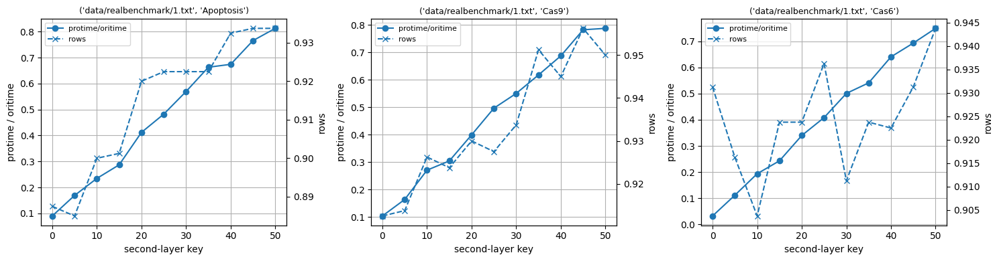

{'0': {'protime': 0.05304064750671387, 'averightrows': 0.8046875, 'averightinrows': 0.8333333333333334, 'dncg': 0.8733500000000001}, '5': {'protime': 0.0722461223602295, 'averightrows': 0.825, 'averightinrows': 0.8833333333333334, 'dncg': 0.89449}, '10': {'protime': 0.09854335784912109, 'averightrows': 0.859375, 'averightinrows': 0.9166666666666667, 'dncg': 0.9167800000000002}, '15': {'protime': 0.08927335739135742, 'averightrows': 0.84375, 'averightinrows': 0.9166666666666667, 'dncg': 0.90617}, '20': {'protime': 0.10603346824645996, 'averightrows': 0.8515625, 'averightinrows': 0.9333333333333333, 'dncg': 0.91197}, '25': {'protime': 0.12297077178955078, 'averightrows': 0.9015625, 'averightinrows': 0.9666666666666666, 'dncg': 0.9590200000000001}, '30': {'protime': 0.17026352882385254, 'averightrows': 0.9078125, 'averightinrows': 0.9833333333333332, 'dncg': 0.9557399999999999}, '35': {'protime': 0.19718480110168457, 'averightrows': 0.915625, 'averightinrows': 1.0, 'dncg': 0.9649700000000

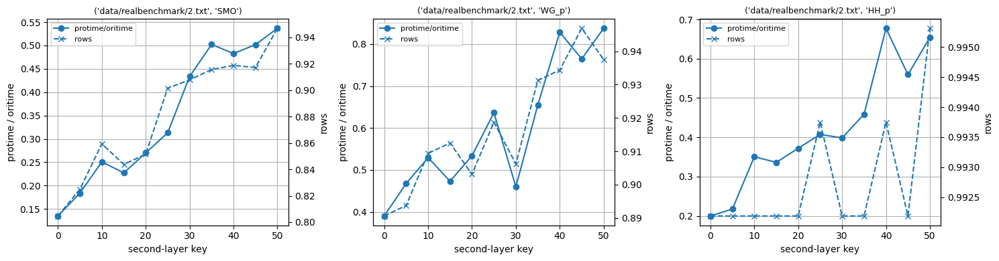

{'0': {'protime': 1.1397804737091064, 'averightrows': 0.96875, 'averightinrows': 1.0, 'dncg': 0.5}, '5': {'protime': 1.2401212692260741, 'averightrows': 0.96875, 'averightinrows': 1.0, 'dncg': 0.5}, '10': {'protime': 1.3406128406524658, 'averightrows': 0.9708333333333332, 'averightinrows': 1.0, 'dncg': 0.5}, '15': {'protime': 1.4080056190490722, 'averightrows': 0.9729166666666668, 'averightinrows': 1.0, 'dncg': 0.5}, '20': {'protime': 1.4504260540008544, 'averightrows': 0.9708333333333332, 'averightinrows': 1.0, 'dncg': 0.5}, '25': {'protime': 1.536992359161377, 'averightrows': 0.9791666666666666, 'averightinrows': 1.0, 'dncg': 0.5}, '30': {'protime': 1.673604154586792, 'averightrows': 0.9791666666666666, 'averightinrows': 1.0, 'dncg': 0.5}, '35': {'protime': 1.818599033355713, 'averightrows': 0.98125, 'averightinrows': 1.0, 'dncg': 0.5}, '40': {'protime': 1.799948024749756, 'averightrows': 0.9875, 'averightinrows': 1.0, 'dncg': 0.5}, '45': {'protime': 1.9306557178497314, 'averightrows

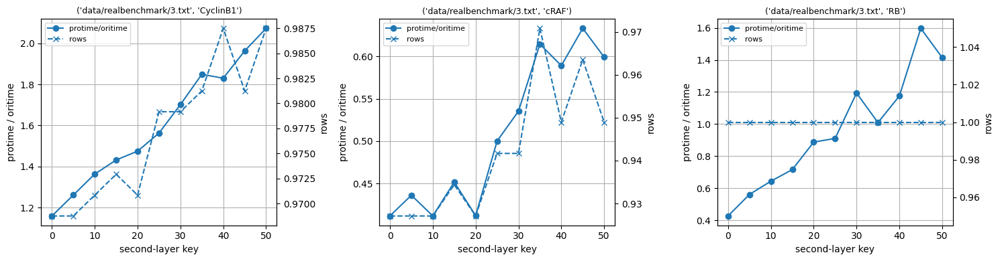

{'0': {'protime': 0.9552645683288574, 'averightrows': 0.9958333333333333, 'averightinrows': 0.9, 'dncg': 0.994}, '5': {'protime': 1.0091633796691895, 'averightrows': 0.9958333333333333, 'averightinrows': 0.9, 'dncg': 0.994}, '10': {'protime': 1.0354969501495361, 'averightrows': 0.9958333333333333, 'averightinrows': 0.9, 'dncg': 0.994}, '15': {'protime': 1.1460135459899903, 'averightrows': 0.9966666666666667, 'averightinrows': 0.9, 'dncg': 0.9952}, '20': {'protime': 1.1800589084625244, 'averightrows': 0.9966666666666667, 'averightinrows': 0.9, 'dncg': 0.9952}, '25': {'protime': 1.2834144592285157, 'averightrows': 0.9966666666666667, 'averightinrows': 0.9, 'dncg': 0.9952}, '30': {'protime': 1.2220730304718017, 'averightrows': 0.9983333333333334, 'averightinrows': 0.9, 'dncg': 0.9975999999999999}, '35': {'protime': 1.4293529987335205, 'averightrows': 0.9974999999999999, 'averightinrows': 0.9, 'dncg': 0.9964000000000001}, '40': {'protime': 1.3016317367553711, 'averightrows': 0.997499999999

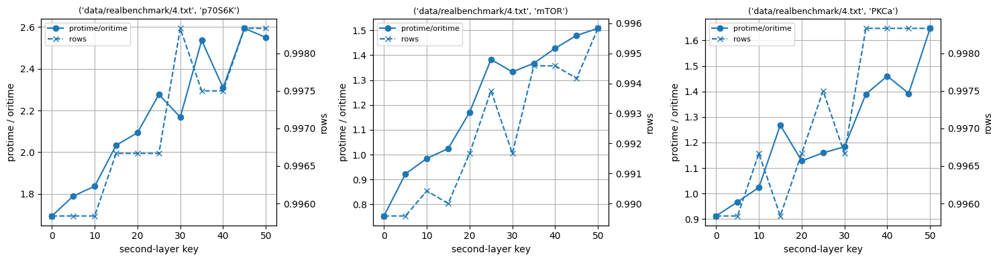

{'0': {'protime': 1.1138516426086427, 'averightrows': 0.7302631578947368, 'averightinrows': 0.8125, 'dncg': 0.9634}, '5': {'protime': 1.2369879245758058, 'averightrows': 0.7368421052631577, 'averightinrows': 0.81875, 'dncg': 0.9589500000000001}, '10': {'protime': 1.491140651702881, 'averightrows': 0.7651315789473685, 'averightinrows': 0.81875, 'dncg': 0.9636799999999999}, '15': {'protime': 1.6370497226715088, 'averightrows': 0.7809210526315791, 'averightinrows': 0.83125, 'dncg': 0.9678100000000001}, '20': {'protime': 1.5939993858337402, 'averightrows': 0.7802631578947368, 'averightinrows': 0.8375, 'dncg': 0.9611000000000001}, '25': {'protime': 1.781729793548584, 'averightrows': 0.7776315789473685, 'averightinrows': 0.8375, 'dncg': 0.9594999999999999}, '30': {'protime': 1.9280192375183105, 'averightrows': 0.7703947368421052, 'averightinrows': 0.834375, 'dncg': 0.9510099999999999}, '35': {'protime': 2.0956982612609862, 'averightrows': 0.8046052631578947, 'averightinrows': 0.834375, 'dncg

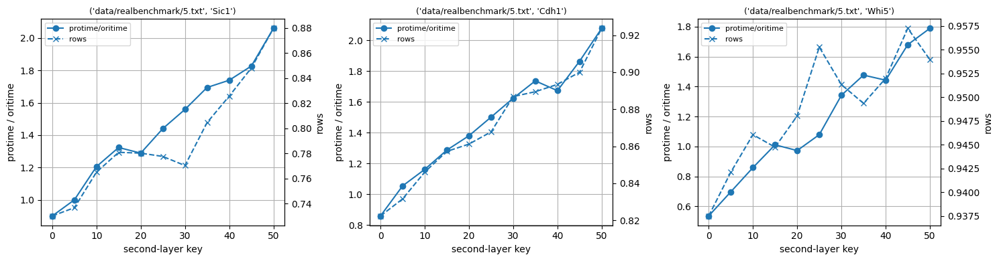

{'0': {'protime': 0.13099350929260253, 'averightrows': 0.8148148148148149, 'averightinrows': 0.7083333333333333, 'dncg': 0.9776}, '5': {'protime': 0.23175544738769532, 'averightrows': 0.837037037037037, 'averightinrows': 0.6916666666666667, 'dncg': 0.9797699999999999}, '10': {'protime': 0.34924778938293455, 'averightrows': 0.8527777777777776, 'averightinrows': 0.65, 'dncg': 0.98532}, '15': {'protime': 0.3894956588745117, 'averightrows': 0.850925925925926, 'averightinrows': 0.7, 'dncg': 0.98559}, '20': {'protime': 0.4108099460601807, 'averightrows': 0.836111111111111, 'averightinrows': 0.6916666666666667, 'dncg': 0.97988}, '25': {'protime': 0.49923195838928225, 'averightrows': 0.8657407407407408, 'averightinrows': 0.75, 'dncg': 0.9861699999999999}, '30': {'protime': 0.5884494304656982, 'averightrows': 0.874074074074074, 'averightinrows': 0.7333333333333334, 'dncg': 0.98948}, '35': {'protime': 0.6357406616210938, 'averightrows': 0.9175925925925925, 'averightinrows': 0.7916666666666666, '

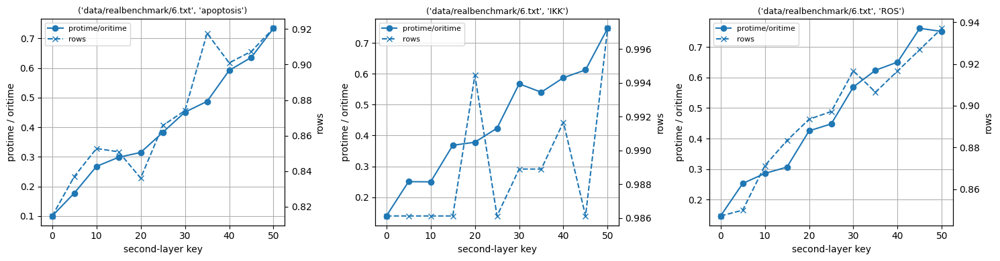

{'0': {'protime': 2.102615737915039, 'averightrows': 0.9186046511627908, 'averightinrows': 0.8125, 'dncg': 0.9429000000000001}, '5': {'protime': 3.087524175643921, 'averightrows': 0.9220930232558139, 'averightinrows': 0.8125, 'dncg': 0.94472}, '10': {'protime': 4.033384990692139, 'averightrows': 0.9220930232558139, 'averightinrows': 0.8125, 'dncg': 0.9448700000000001}, '15': {'protime': 5.009065866470337, 'averightrows': 0.9220930232558139, 'averightinrows': 0.8125, 'dncg': 0.94467}, '20': {'protime': 6.104249095916748, 'averightrows': 0.9470930232558139, 'averightinrows': 0.8125, 'dncg': 0.96234}, '25': {'protime': 6.805116653442383, 'averightrows': 0.9424418604651162, 'averightinrows': 0.8125, 'dncg': 0.9546299999999999}, '30': {'protime': 7.817286205291748, 'averightrows': 0.9436046511627907, 'averightinrows': 0.8125, 'dncg': 0.96254}, '35': {'protime': 8.621019744873047, 'averightrows': 0.9482558139534885, 'averightinrows': 0.8125, 'dncg': 0.9646700000000001}, '40': {'protime': 9.5

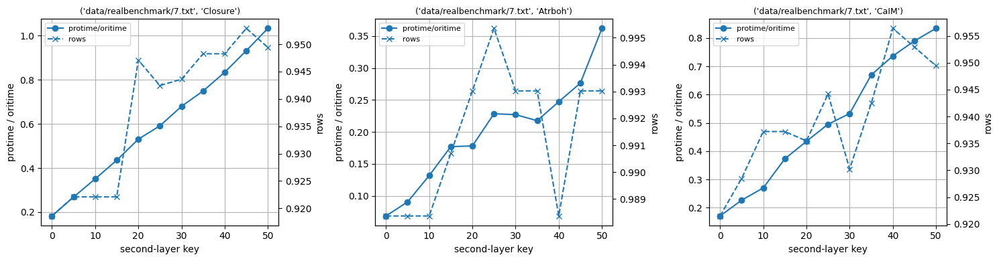

{'0': {'protime': 0.3658470153808594, 'averightrows': 0.9945652173913043, 'averightinrows': 0.96875, 'dncg': 0.99275}, '5': {'protime': 0.4382716178894043, 'averightrows': 0.9956521739130434, 'averightinrows': 0.96875, 'dncg': 0.9942}, '10': {'protime': 0.6147425651550293, 'averightrows': 0.9956521739130434, 'averightinrows': 0.96875, 'dncg': 0.9942}, '15': {'protime': 0.7206270217895507, 'averightrows': 0.9956521739130434, 'averightinrows': 0.96875, 'dncg': 0.9942}, '20': {'protime': 0.7659052848815918, 'averightrows': 0.9945652173913043, 'averightinrows': 0.96875, 'dncg': 0.99275}, '25': {'protime': 0.7896348476409912, 'averightrows': 0.9945652173913043, 'averightinrows': 0.96875, 'dncg': 0.99275}, '30': {'protime': 1.0035492420196532, 'averightrows': 0.9956521739130435, 'averightinrows': 0.96875, 'dncg': 0.9942}, '35': {'protime': 0.9829156875610352, 'averightrows': 0.9945652173913043, 'averightinrows': 0.96875, 'dncg': 0.99275}, '40': {'protime': 1.2924200534820556, 'averightrows':

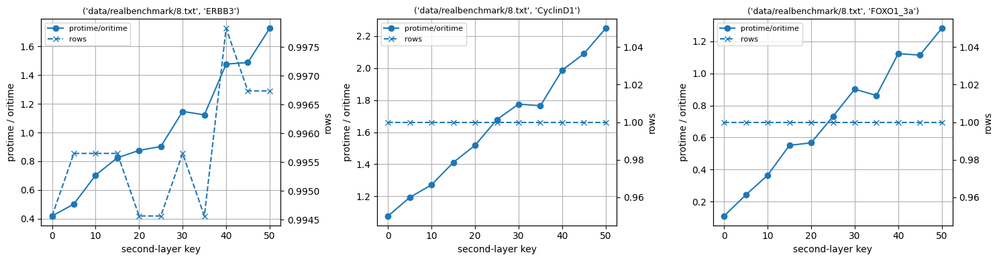

{'0': {'protime': 1.0423915386199951, 'averightrows': 0.9583333333333334, 'averightinrows': 0.875, 'dncg': 0.8903000000000001}, '5': {'protime': 1.1455465793609618, 'averightrows': 0.9591666666666667, 'averightinrows': 0.875, 'dncg': 0.89025}, '10': {'protime': 1.167639923095703, 'averightrows': 0.9650000000000001, 'averightinrows': 0.875, 'dncg': 0.9116299999999999}, '15': {'protime': 1.2920114994049072, 'averightrows': 0.9791666666666667, 'averightinrows': 0.875, 'dncg': 0.9542400000000001}, '20': {'protime': 1.2899046897888184, 'averightrows': 0.9675, 'averightinrows': 0.875, 'dncg': 0.91149}, '25': {'protime': 1.4079657077789307, 'averightrows': 0.9608333333333334, 'averightinrows': 0.875, 'dncg': 0.8901600000000001}, '30': {'protime': 1.3410030364990235, 'averightrows': 0.9791666666666667, 'averightinrows': 0.875, 'dncg': 0.9546199999999999}, '35': {'protime': 1.53094162940979, 'averightrows': 0.9808333333333333, 'averightinrows': 0.875, 'dncg': 0.9545200000000001}, '40': {'protim

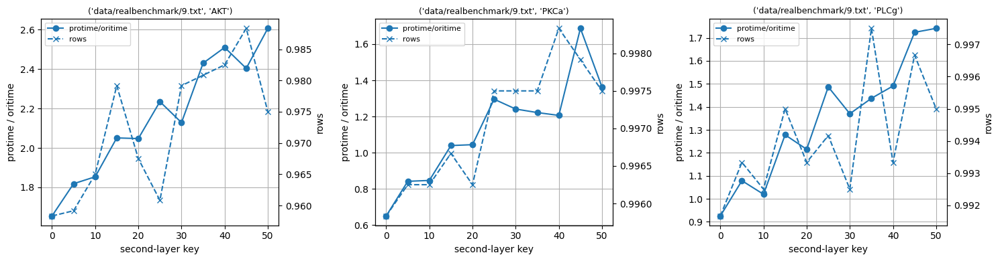

{'0': {'protime': 0.3957788944244385, 'averightrows': 1.0, 'averightinrows': 1.0, 'dncg': 1.0}, '5': {'protime': 0.3965956687927246, 'averightrows': 1.0, 'averightinrows': 1.0, 'dncg': 1.0}, '10': {'protime': 0.3979731559753418, 'averightrows': 1.0, 'averightinrows': 1.0, 'dncg': 1.0}, '15': {'protime': 0.39780511856079104, 'averightrows': 1.0, 'averightinrows': 1.0, 'dncg': 1.0}, '20': {'protime': 0.3984838008880615, 'averightrows': 1.0, 'averightinrows': 1.0, 'dncg': 1.0}, '25': {'protime': 0.39911479949951173, 'averightrows': 1.0, 'averightinrows': 1.0, 'dncg': 1.0}, '30': {'protime': 0.3969123363494873, 'averightrows': 1.0, 'averightinrows': 1.0, 'dncg': 1.0}, '35': {'protime': 0.3994180202484131, 'averightrows': 1.0, 'averightinrows': 1.0, 'dncg': 1.0}, '40': {'protime': 0.39835529327392577, 'averightrows': 1.0, 'averightinrows': 1.0, 'dncg': 1.0}, '45': {'protime': 0.3990612506866455, 'averightrows': 1.0, 'averightinrows': 1.0, 'dncg': 1.0}, '50': {'protime': 0.39761981964111326,

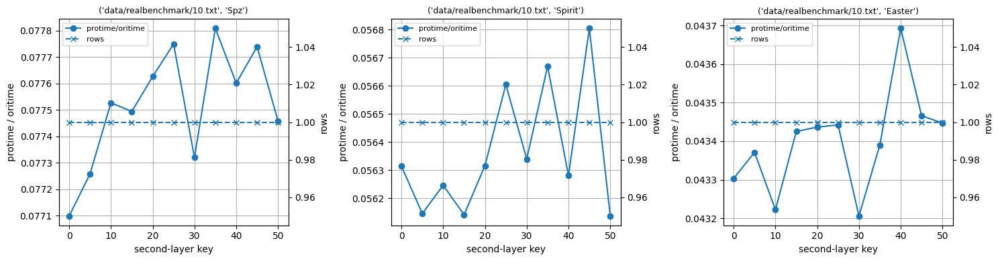

{'0': {'protime': 1.963883113861084, 'averightrows': 0.9609375, 'averightinrows': 1.0, 'dncg': 0.165}, '5': {'protime': 2.148061466217041, 'averightrows': 0.9682291666666666, 'averightinrows': 1.0, 'dncg': 0.165}, '10': {'protime': 2.1760114669799804, 'averightrows': 0.9692708333333334, 'averightinrows': 1.0, 'dncg': 0.29900000000000004}, '15': {'protime': 2.20412917137146, 'averightrows': 0.9614583333333332, 'averightinrows': 1.0, 'dncg': 0.23200000000000004}, '20': {'protime': 2.3817018985748293, 'averightrows': 0.9682291666666668, 'averightinrows': 1.0, 'dncg': 0.165}, '25': {'protime': 2.569208860397339, 'averightrows': 0.9760416666666666, 'averightinrows': 1.0, 'dncg': 0.23200000000000004}, '30': {'protime': 2.5038620471954345, 'averightrows': 0.9682291666666666, 'averightinrows': 1.0, 'dncg': 0.165}, '35': {'protime': 2.502005434036255, 'averightrows': 0.9692708333333334, 'averightinrows': 1.0, 'dncg': 0.29900000000000004}, '40': {'protime': 2.9488332748413084, 'averightrows': 0.

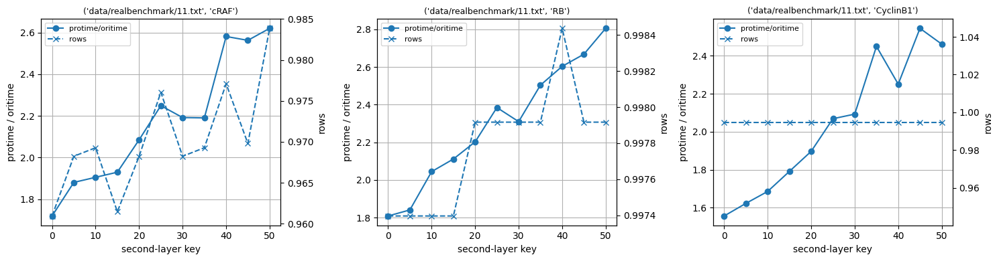

{'0': {'protime': 0.5771800518035889, 'averightrows': 0.9916666666666668, 'averightinrows': 0.9, 'dncg': 0.98695}, '5': {'protime': 0.6420173645019531, 'averightrows': 0.9925, 'averightinrows': 0.9, 'dncg': 0.98838}, '10': {'protime': 0.6043972969055176, 'averightrows': 0.9925, 'averightinrows': 0.9, 'dncg': 0.98838}, '15': {'protime': 0.7127201080322265, 'averightrows': 0.9916666666666668, 'averightinrows': 0.9, 'dncg': 0.98695}, '20': {'protime': 0.7164935111999512, 'averightrows': 0.9925, 'averightinrows': 0.9, 'dncg': 0.9883799999999999}, '25': {'protime': 0.7876691818237305, 'averightrows': 0.9941666666666666, 'averightinrows': 0.9, 'dncg': 0.9912400000000001}, '30': {'protime': 0.7754503726959229, 'averightrows': 0.9933333333333334, 'averightinrows': 0.9, 'dncg': 0.9898100000000001}, '35': {'protime': 0.8292139530181885, 'averightrows': 0.9966666666666668, 'averightinrows': 0.9, 'dncg': 0.9950300000000001}, '40': {'protime': 0.8363568305969238, 'averightrows': 0.9941666666666666,

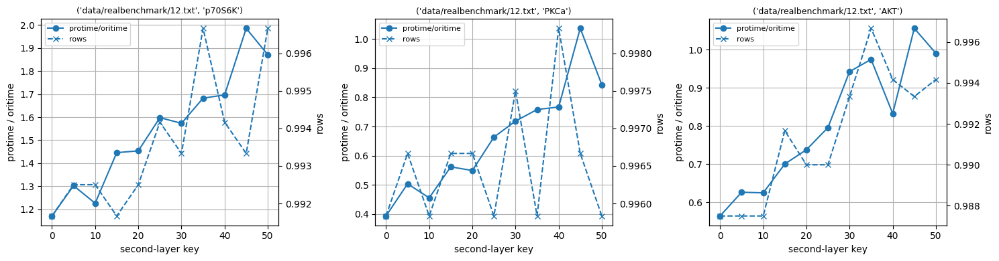

{'0': {'protime': 0.3009798049926758, 'averightrows': 0.940340909090909, 'averightinrows': 0.953125, 'dncg': 0.5825}, '5': {'protime': 0.4066627979278564, 'averightrows': 0.9448863636363637, 'averightinrows': 0.921875, 'dncg': 0.6497499999999999}, '10': {'protime': 0.5592724800109863, 'averightrows': 0.9420454545454545, 'averightinrows': 0.9625, 'dncg': 0.58402}, '15': {'protime': 0.6517377376556397, 'averightrows': 0.9528409090909091, 'averightinrows': 0.928125, 'dncg': 0.7302099999999999}, '20': {'protime': 0.7539782047271728, 'averightrows': 0.9494318181818182, 'averightinrows': 0.9375, 'dncg': 0.65565}, '25': {'protime': 0.886417007446289, 'averightrows': 0.952840909090909, 'averightinrows': 0.94375, 'dncg': 0.6643399999999999}, '30': {'protime': 1.0200071334838867, 'averightrows': 0.9568181818181818, 'averightinrows': 0.953125, 'dncg': 0.66966}, '35': {'protime': 1.1075803279876708, 'averightrows': 0.9619318181818182, 'averightinrows': 0.865625, 'dncg': 0.8506499999999999}, '40': 

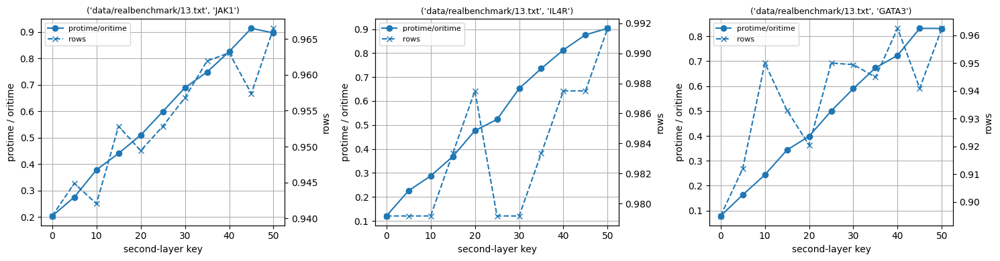

{'0': {'protime': 0.23304986953735352, 'averightrows': 0.9743589743589742, 'averightinrows': 0.875, 'dncg': 0.6597999999999999}, '5': {'protime': 0.313739013671875, 'averightrows': 0.9756410256410255, 'averightinrows': 0.8833333333333334, 'dncg': 0.6597999999999999}, '10': {'protime': 0.44879822731018065, 'averightrows': 0.9769230769230768, 'averightinrows': 0.8833333333333332, 'dncg': 0.6886699999999999}, '15': {'protime': 0.4560214042663574, 'averightrows': 0.9794871794871793, 'averightinrows': 0.8916666666666666, 'dncg': 0.7220799999999999}, '20': {'protime': 0.5615963935852051, 'averightrows': 0.9807692307692308, 'averightinrows': 0.8916666666666666, 'dncg': 0.69787}, '25': {'protime': 0.6699148178100586, 'averightrows': 0.9794871794871793, 'averightinrows': 0.9, 'dncg': 0.66213}, '30': {'protime': 0.664339542388916, 'averightrows': 0.9820512820512821, 'averightinrows': 0.8833333333333334, 'dncg': 0.80328}, '35': {'protime': 0.643558931350708, 'averightrows': 0.9794871794871796, 'a

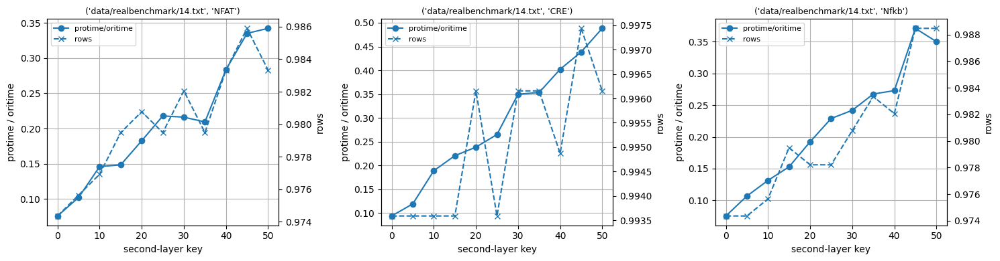

{'0': {'protime': 22.244615602493287, 'averightrows': 1.0, 'averightinrows': 1.0, 'dncg': 1.0}, '5': {'protime': 22.270643186569213, 'averightrows': 1.0, 'averightinrows': 1.0, 'dncg': 1.0}, '10': {'protime': 22.27579445838928, 'averightrows': 1.0, 'averightinrows': 1.0, 'dncg': 1.0}, '15': {'protime': 22.246470165252685, 'averightrows': 1.0, 'averightinrows': 1.0, 'dncg': 1.0}, '20': {'protime': 22.412571382522582, 'averightrows': 1.0, 'averightinrows': 1.0, 'dncg': 1.0}, '25': {'protime': 22.267203283309936, 'averightrows': 1.0, 'averightinrows': 1.0, 'dncg': 1.0}, '30': {'protime': 22.30082607269287, 'averightrows': 1.0, 'averightinrows': 1.0, 'dncg': 1.0}, '35': {'protime': 22.37087516784668, 'averightrows': 1.0, 'averightinrows': 1.0, 'dncg': 1.0}, '40': {'protime': 22.505747175216676, 'averightrows': 1.0, 'averightinrows': 1.0, 'dncg': 1.0}, '45': {'protime': 22.42130026817322, 'averightrows': 1.0, 'averightinrows': 1.0, 'dncg': 1.0}, '50': {'protime': 22.341551113128663, 'averig

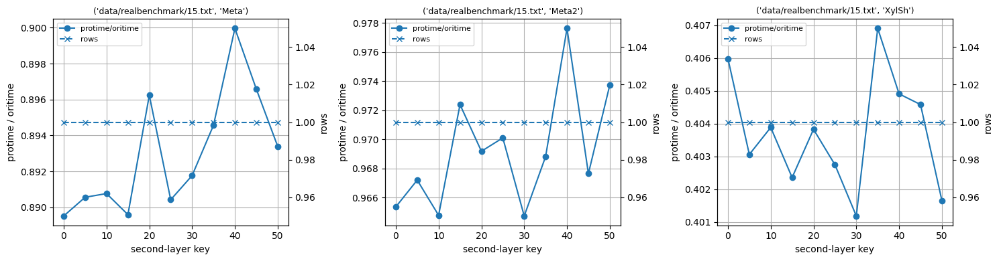

{'0': {'protime': 58.29968595504761, 'averightrows': 1.0, 'averightinrows': 1.0, 'dncg': 1.0}, '5': {'protime': 117.23806476593018, 'averightrows': 1.0, 'averightinrows': 1.0, 'dncg': 1.0}, '10': {'protime': 168.28136348724365, 'averightrows': 1.0, 'averightinrows': 1.0, 'dncg': 1.0}, '15': {'protime': 173.83699941635132, 'averightrows': 1.0, 'averightinrows': 1.0, 'dncg': 1.0}, '20': {'protime': 220.193421792984, 'averightrows': 1.0, 'averightinrows': 1.0, 'dncg': 1.0}, '25': {'protime': 262.5180183410645, 'averightrows': 1.0, 'averightinrows': 1.0, 'dncg': 1.0}, '30': {'protime': 267.7409479141235, 'averightrows': 1.0, 'averightinrows': 1.0, 'dncg': 1.0}, '35': {'protime': 284.1839818000793, 'averightrows': 1.0, 'averightinrows': 1.0, 'dncg': 1.0}, '40': {'protime': 314.20259323120115, 'averightrows': 1.0, 'averightinrows': 1.0, 'dncg': 1.0}, '45': {'protime': 345.93641152381895, 'averightrows': 1.0, 'averightinrows': 1.0, 'dncg': 1.0}, '50': {'protime': 384.04903202056886, 'averight

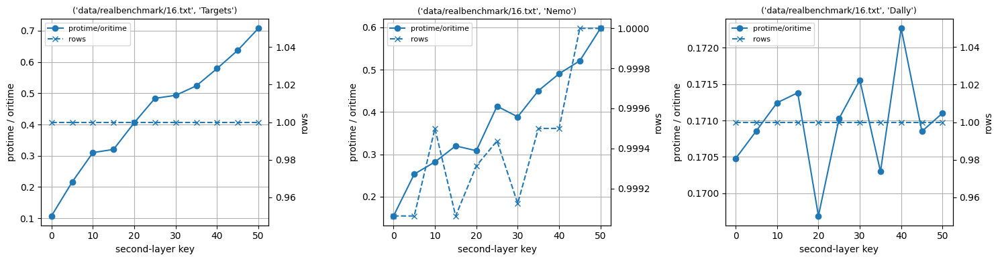

{'0': {'protime': 32.80878572463989, 'averightrows': 0.973606418918919, 'averightinrows': 0.9730902777777779, 'dncg': 0.77015}, '5': {'protime': 49.86482176780701, 'averightrows': 0.9756967905405405, 'averightinrows': 0.9739583333333334, 'dncg': 0.7906299999999999}, '10': {'protime': 58.20101628303528, 'averightrows': 0.9774704391891891, 'averightinrows': 0.9729166666666667, 'dncg': 0.7841099999999999}, '15': {'protime': 79.20540952682495, 'averightrows': 0.9800253378378379, 'averightinrows': 0.9737847222222223, 'dncg': 0.82589}, '20': {'protime': 92.3934956073761, 'averightrows': 0.9788640202702702, 'averightinrows': 0.9737847222222221, 'dncg': 0.7832700000000001}, '25': {'protime': 94.35600934028625, 'averightrows': 0.979518581081081, 'averightinrows': 0.9732638888888889, 'dncg': 0.80332}, '30': {'protime': 116.18764643669128, 'averightrows': 0.9813344594594593, 'averightinrows': 0.9741319444444445, 'dncg': 0.7855200000000001}, '35': {'protime': 119.06708192825317, 'averightrows': 0.

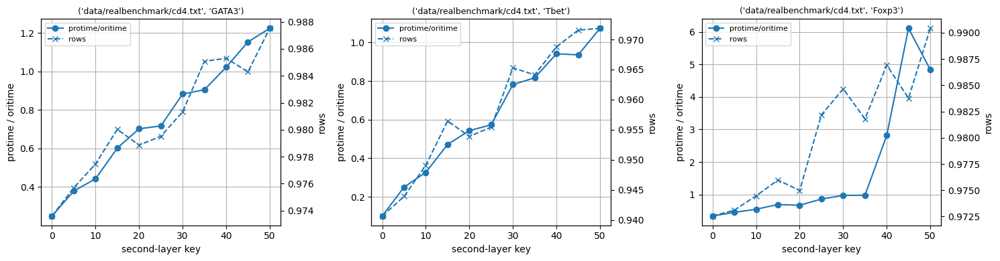

{'0': {'protime': 1.2930733680725097, 'averightrows': 0.9962686567164181, 'averightinrows': 0.9791666666666666, 'dncg': 0.9963999999999998}, '5': {'protime': 5.922745609283448, 'averightrows': 0.9962686567164181, 'averightinrows': 0.9791666666666666, 'dncg': 0.9963999999999998}, '10': {'protime': 7.825934219360351, 'averightrows': 0.9970149253731343, 'averightinrows': 0.9833333333333332, 'dncg': 0.99712}, '15': {'protime': 198.00848994255065, 'averightrows': 0.9966417910447761, 'averightinrows': 0.9791666666666666, 'dncg': 0.99712}, '20': {'protime': 12.69508728981018, 'averightrows': 0.9970149253731343, 'averightinrows': 0.9833333333333334, 'dncg': 0.99712}, '25': {'protime': 36.15752391815185, 'averightrows': 0.9966417910447761, 'averightinrows': 0.9833333333333332, 'dncg': 0.9963999999999998}, '30': {'protime': 211.87080783843993, 'averightrows': 0.9981343283582088, 'averightinrows': 0.9916666666666666, 'dncg': 0.9978400000000001}, '35': {'protime': 235.8051869392395, 'averightrows'

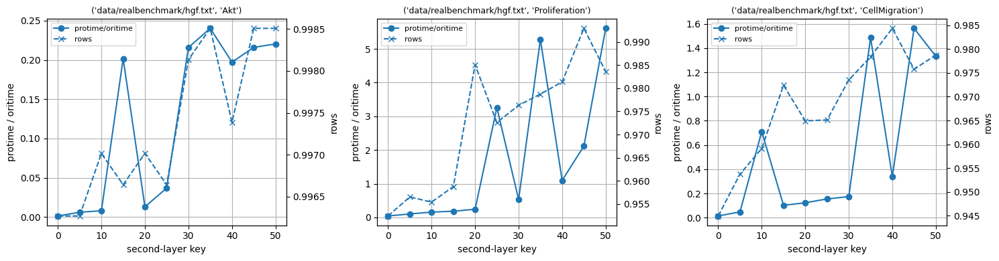

In [ ]:
import json
import matplotlib.pyplot as plt

# ----- Load data -----
with open("output.json", "r") as f:
    data = json.load(f)

def parse_tuple(s):
    return eval(s)

parsed = {parse_tuple(k): v for k, v in data.items()}

keys = list(parsed.keys())

# ---- precompute global ranges ----
all_ratio = []
all_rows = []

for k in parsed:
    oritime = parsed[k]['oritime']
    item = parsed[k]['propercentage']
    for x, v in item.items():
        all_ratio.append(v["protime"] / oritime)
        all_rows.append(v["averightrows"])

ratio_min, ratio_max = min(all_ratio), max(all_ratio)
rows_min, rows_max = min(all_rows), max(all_rows)


for i in range(0, len(keys), 3):
    group = keys[i:i+3]

    fig, axes = plt.subplots(1, len(group), figsize=(15, 4))

    if len(group) == 1:
        axes = [axes]

    for ax, k in zip(axes, group):
        oritime = parsed[k]['oritime']
        item = parsed[k]['propercentage']
        print(item)
        x_vals = sorted(int(x) for x in item.keys())
        ratio = [
            item[str(x)]["protime"] / oritime
            for x in x_vals
        ]
        rows = [item[str(x)]["averightrows"] for x in x_vals]
        inrows = [item[str(x)]["averightinrows"] for x in x_vals]

        # left y-axis: ratio
        l1, = ax.plot(x_vals, ratio, marker="o", label="protime/oritime")
        # left y-axis
        ax.set_ylim(ratio_min, ratio_max)

        # right y-axis
        ax2.set_ylim(rows_min, rows_max)
        
        ax.set_ylabel("protime / oritime")
        ax.set_xlabel("second-layer key")
        ax.grid(True)

        # right y-axis: rows
        ax2 = ax.twinx()
        l2, = ax2.plot(
            x_vals, rows, marker="x", linestyle="--", label="rows"
        )
        ax2.set_ylabel("rows")

        # combined legend
        ax.legend([l1, l2], ["protime/oritime", "rows"], fontsize=8)

        ax.set_title(str(k), fontsize=9)

    plt.tight_layout()
    plt.show()
